## Packets

In [1]:
import numpy as np
import pandas as pd
import networkx as nx
import holoviews as hv

from sklearn.preprocessing import RobustScaler

## Biogrid dataset

In [2]:
biogrid = pd.read_csv('./Datasets/BIOGRID-ORGANISM-Homo_sapiens-4.4.206.tab3.txt', sep='\t')
biogrid.info()

/var/folders/zz/ytrc_g0d5mb2tkg2gjd_zjqr0000gn/T/ipykernel_17117/2936406807.py:1: DtypeWarning: Columns (1,2,18) have mixed types. Specify dtype option on import or set low_memory=False.
  biogrid = pd.read_csv('./Datasets/BIOGRID-ORGANISM-Homo_sapiens-4.4.206.tab3.txt', sep='\t')


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 981398 entries, 0 to 981397
Data columns (total 37 columns):
 #   Column                              Non-Null Count   Dtype 
---  ------                              --------------   ----- 
 0   #BioGRID Interaction ID             981398 non-null  int64 
 1   Entrez Gene Interactor A            981398 non-null  object
 2   Entrez Gene Interactor B            981398 non-null  object
 3   BioGRID ID Interactor A             981398 non-null  int64 
 4   BioGRID ID Interactor B             981398 non-null  int64 
 5   Systematic Name Interactor A        981398 non-null  object
 6   Systematic Name Interactor B        981398 non-null  object
 7   Official Symbol Interactor A        981398 non-null  object
 8   Official Symbol Interactor B        981398 non-null  object
 9   Synonyms Interactor A               981398 non-null  object
 10  Synonyms Interactor B               981398 non-null  object
 11  Experimental System                 981

In [3]:
# Filtering non-human proteins
biogrid = biogrid[(biogrid['Organism ID Interactor A'] == 9606) & (biogrid['Organism ID Interactor B'] == 9606)]
biogrid.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 913180 entries, 0 to 981397
Data columns (total 37 columns):
 #   Column                              Non-Null Count   Dtype 
---  ------                              --------------   ----- 
 0   #BioGRID Interaction ID             913180 non-null  int64 
 1   Entrez Gene Interactor A            913180 non-null  object
 2   Entrez Gene Interactor B            913180 non-null  object
 3   BioGRID ID Interactor A             913180 non-null  int64 
 4   BioGRID ID Interactor B             913180 non-null  int64 
 5   Systematic Name Interactor A        913180 non-null  object
 6   Systematic Name Interactor B        913180 non-null  object
 7   Official Symbol Interactor A        913180 non-null  object
 8   Official Symbol Interactor B        913180 non-null  object
 9   Synonyms Interactor A               913180 non-null  object
 10  Synonyms Interactor B               913180 non-null  object
 11  Experimental System                 913

In [70]:
# sanity check to confirm that we have filtered all protein types that are not related to humans
len(pd.unique(biogrid['Organism ID Interactor B']))

1

## Graph

In [4]:
# Instead of using the NetworkX built-in method to load a pandas dataframe into a NX graph,
# let's iterate the columns, so if it is necessary in the future to add more controls in the
# creation of the graph we have already the function that scans the dataframe and adds nodes
# and edges to the graph 

G = nx.Graph()

for index, row in biogrid.iterrows():
    p1 = row['Official Symbol Interactor A'].replace('-', '_').replace('.', '_')
    p2 = row['Official Symbol Interactor B'].replace('-', '_').replace('.', '_')

    G.add_edge(p1, p2)

print('[+] Added', len(list(G.nodes)), 'nodes')
print('[+] Added', len(list(G.edges)), 'edges')

[+] Added 19764 nodes
[+] Added 682198 edges


In [5]:
# Remove self loops
G.remove_edges_from(nx.selfloop_edges(G))

print('[+] G now has', len(list(G.nodes)), 'nodes')
print('[+] G now has', len(list(G.edges)), 'edges')

[+] G now has 19764 nodes
[+] G now has 678932 edges


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
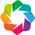

:Graph   [start,end]

In [ ]:
hv.extension('bokeh')
%opts Graph [width=400, height=400]
padding = dict(x=(-1.1, 1.1), y=(-1.1, 1.1))
hv.Graph.from_networkx(G, nx.layout.spring_layout).redim.range(**padding)

In [6]:
# Let's see how many connected compontents there are
nx.number_connected_components(G)

4

In [7]:
# Let's tale only the largest connected component
lcc = max(nx.connected_components(G), key=len)

G = G.subgraph(lcc).copy()

print('[+] LCC has', len(list(G.nodes)), 'nodes')
print('[+] LCC has', len(list(G.edges)), 'edges')

[+] LCC has 19761 nodes
[+] LCC has 678932 edges


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
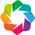

:Graph   [start,end]

In [ ]:
# Visualize the graph's Largest Connected Component

hv.extension('bokeh')
%opts Graph [width=400, height=400]
padding = dict(x=(-1.1, 1.1), y=(-1.1, 1.1))
hv.Graph.from_networkx(G, nx.layout.spring_layout).redim.range(**padding)

The graph saved in 'original_graph.gml' contains the LCC. Here the nodes have only the names of the associated gene's ID

In [8]:
# Save original graph to file
nx.write_gml(G, 'Graphs/original_graph.gml')

## Graph with centrality measures

In [9]:
# let's make a copy of the original graph
G1= nx.read_gml('Graphs/original_graph.gml')

# all this functions return a dictionary with {node: value}
print('[+] Degree centrality...', end='')
degree_centrality       = nx.algorithms.centrality.degree_centrality(G1)
print('ok')

print('[+] Betweenness centrality...', end='')
betweenness_centrality  = nx.algorithms.centrality.betweenness_centrality(G1)
print('ok')

print('[+] Eigenvector centrality...', end='')
eigenvector_centrality  = nx.algorithms.centrality.eigenvector_centrality(G1)
print('ok')

print('[+] Closeness centrality...', end='')
closeness_centrality    = nx.algorithms.centrality.closeness_centrality(G1)
print('ok')

[+] Degree centrality...ok
[+] Betweenness centrality...ok
[+] Eigenvector centrality...ok
[+] Closeness centrality...ok


In [10]:
for node in G1:
  G1.nodes[node]['degree']       = degree_centrality[node]
  G1.nodes[node]['betweenness']  = betweenness_centrality[node]
  G1.nodes[node]['eigenvector']  = eigenvector_centrality[node]
  G1.nodes[node]['closeness']    = closeness_centrality[node]

In [11]:
# Save the graph to avoid recomputing the centrality measures (very time consuming!)
# from https://networkx.org/documentation/stable/reference/readwrite/generated/networkx.readwrite.gml.write_gml.html

nx.write_gml(G1, 'Graphs/graph_with_centrality.gml')

Normalizing the centrality measures' values

In [12]:
G2 = nx.read_gml('Graphs/graph_with_centrality.gml')

degree      = []
betweenness = []
eigenvector = []
closeness   = []

for node in G2:
    degree.append(G2.nodes[node]['degree'])
    betweenness.append(G2.nodes[node]['betweenness'])
    eigenvector.append(G2.nodes[node]['eigenvector'])
    closeness.append(G2.nodes[node]['closeness'])

centrality_measures = [degree, betweenness, eigenvector, closeness]

transformer = RobustScaler().fit(np.array(centrality_measures))
transformer.transform(np.array(centrality_measures))

i = 0
for node in G2:
    G2.nodes[node]['degree']        = centrality_measures[0][i]
    G2.nodes[node]['betweenness']   = centrality_measures[1][i]
    G2.nodes[node]['eigenvector']   = centrality_measures[2][i]
    G2.nodes[node]['closeness']     = centrality_measures[3][i]
    i += 1

nx.write_gml(G2, 'Graphs/graph_with_normalized_centrality.gml')

## Graph with NeDBIT features

In [3]:
G3 = nx.read_gml('Graphs/original_graph.gml')
G3.number_of_nodes()

19761

In [4]:
nedbit_features = pd.read_csv('Datasets/C0006142_Malignant_neoplasm_of_breast_features.csv')
nedbit_features.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19761 entries, 0 to 19760
Data columns (total 8 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   name      19761 non-null  object 
 1   class     19761 non-null  int64  
 2   degree    19761 non-null  int64  
 3   ring      19761 non-null  int64  
 4   NetRank   19761 non-null  float64
 5   NetShort  19761 non-null  float64
 6   HeatDiff  19761 non-null  float64
 7   InfoDiff  19761 non-null  float64
dtypes: float64(4), int64(3), object(1)
memory usage: 1.2+ MB


Before putting the features into the graph, they need to be normalized, to avoid that features like the degree of a node, usually with higher values that the other features, are weighted more.

In [6]:
# Normalization

# Get the lists of the features' values from the pandas dataframe
degree      = nedbit_features['degree'].tolist()
ring        = nedbit_features['ring'].tolist()
NetRank     = nedbit_features['NetRank'].tolist()
NetShort    = nedbit_features['NetShort'].tolist()
HeatDiff    = nedbit_features['HeatDiff'].tolist()
InfoDiff    = nedbit_features['InfoDiff'].tolist()

features = [degree, ring, NetRank, NetShort, HeatDiff, InfoDiff]
# features = [NetRank, NetShort, HeatDiff, InfoDiff]

transformer = RobustScaler().fit(np.array(features))
features = transformer.transform(np.array(features))

i = 0
for node in G3:
    G3.nodes[node]['degree']    = features[0][i]
    G3.nodes[node]['ring']      = features[1][i]
    G3.nodes[node]['NetRank']   = features[2][i]
    G3.nodes[node]['NetShort']  = features[3][i]
    G3.nodes[node]['HeatDiff']  = features[4][i]
    G3.nodes[node]['InfoDiff']  = features[5][i]
    i += 1

nx.write_gml(G3, 'Graphs/graph_with_nedbit.gml')

### Adding score to NeDBIT features

In [4]:
G4 = nx.read_gml('Graphs/graph_with_nedbit.gml')
scores = pd.read_csv('Datasets/C0006142_Malignant_neoplasm_of_breast_features_Score.csv')
scores = dict(zip(scores['name'], scores['out']))

for node in G4:
    G4.nodes[node]['score'] = scores[node]

nx.write_gml(G4, 'Graphs/graph_with_nedbit_score.gml')